In [1]:
!pip install inspyred
import os

# As needed, reset cwd to jupyter notebook location
nb4_path = (
    "/mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations"
    "/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing"
    "/batch_run_files/"
)
if os.getcwd() != nb4_path:
    os.chdir(nb4_path)

In [2]:
## NB3 Functions
from netpyne import specs
import shutil

##
def move_plots_to_plots_folder(gen_path):
    # import shutil
    # import os
    # Move plots to plots folder
    # General Plot folder
    #plots_folder = '/mnt/disk15tb/adam/git_workspace/netpyne/hdmea_simulations/BurstingPlotDevelopment/nb4_selecting_params1/plots/'
    plots_folder = nb4_path.replace('batch_run_files', 'plots')
    if not os.path.exists(plots_folder):
        os.makedirs(plots_folder)  

    #destination for gen plots
    gen_dir = os.path.basename(os.path.normpath(gen_path))
    gen_plot_path = plots_folder + gen_dir + '/'
    if not os.path.exists(gen_plot_path):
        os.makedirs(gen_plot_path) 

    # Move plots to gen_plot_path
    for root, dirs, files in os.walk(gen_path):
        for file in files:
            if file.endswith(".png") or file.endswith(".svg"):                
                #control file names
                file = control_file_names(root, file)
                
                if 'raster' in file:
                    #destination for gen raster plots
                    gen_raster_path = gen_plot_path + 'raster/'
                    if not os.path.exists(gen_raster_path):
                        os.makedirs(gen_raster_path)
                    shutil.move(root+'/'+file, gen_raster_path+file)

                elif '2Dnet' in file:
                     #destination for net_conns plots
                    net_conns_path = gen_plot_path + '2Dnet_conns/'
                    if not os.path.exists(net_conns_path):
                        os.makedirs(net_conns_path)                
                    shutil.move(root+'/'+file, net_conns_path+file)

                elif 'conn_matrix' in file:
                    #destination for connectivity matrix plots
                    conn_matrix_path = gen_plot_path + 'conn_matrix/'
                    if not os.path.exists(conn_matrix_path):
                        os.makedirs(conn_matrix_path)
                    shutil.move(root+'/'+file, conn_matrix_path+file)

                elif 'network_activity' in file:
                    #destination for network_activity
                    net_activity_path = gen_plot_path + 'net_activity/'
                    if not os.path.exists(net_activity_path):
                        os.makedirs(net_activity_path)                            
                    shutil.move(root+'/'+file, net_activity_path+file)

                elif 'net_activity_raster' in file:
                    #destination for network_activity and raster (combined_fig)
                    net_activity_raster_path = gen_plot_path + 'net_activity_raster_figs/'
                    if not os.path.exists(net_activity_raster_path):
                        os.makedirs(net_activity_raster_path)                   
                    shutil.move(root+'/'+file, net_activity_raster_path+file)

                elif 'conn_summary' in file:
                    #destination for connectivity matrix and_net_conns plots (combined_fig)
                    conn_matrix_net_conns_path = gen_plot_path + 'conn_summary_figs/'
                    if not os.path.exists(conn_matrix_net_conns_path):
                        os.makedirs(conn_matrix_net_conns_path)                    
                    shutil.move(root+'/'+file, conn_matrix_net_conns_path+file)   

                elif 'param_summary' in file:
                    #destination for param_mod_summary_figs (combined_fig)
                    param_mod_summary_path = gen_plot_path + 'param_summary_figs/'
                    if not os.path.exists(param_mod_summary_path):
                        os.makedirs(param_mod_summary_path) 
                    shutil.move(root+'/'+file, param_mod_summary_path+file)

                elif 'gen_summary' in file: #or 'gen_summary_figure' in file:
                     #destination for generation_summary (combined_fig)
                    gen_summary_path = gen_plot_path + 'gen_summary_figs/'
                    if not os.path.exists(gen_summary_path):
                        os.makedirs(gen_summary_path)
                    shutil.move(root+'/'+file, gen_summary_path+file)

                elif'neuron_locs' in file: # or 'locs' in file:                
                    #destination for neuron location plots
                    neuron_loc_path = gen_plot_path # + 'neuron_loc/'
                    if not os.path.exists(neuron_loc_path):
                        os.makedirs(neuron_loc_path)
                    if os.path.exists(neuron_loc_path+file):
                        os.remove(root+'/'+file)
                    else: shutil.move(root+'/'+file, neuron_loc_path+file)
                
                elif 'sample_trace' in file:
                    #destination for sample trace plots
                    sample_trace_path = gen_plot_path + 'sample_trace_fig/'
                    if not os.path.exists(sample_trace_path):
                        os.makedirs(sample_trace_path)
                    shutil.move(root+'/'+file, sample_trace_path+file)

                #elif 'locs'
    
    #Quality check
    NetworkBurst_and_Raster_Figs = gen_path + 'NetworkBurst_and_Raster_Figs/'
    #assert that this folder is empty before deleting
    if os.path.exists(NetworkBurst_and_Raster_Figs):
        #assert that this folder is empty, else raise error
        assert not os.listdir(NetworkBurst_and_Raster_Figs), "NetworkBurst_and_Raster_Figs is not empty"
        os.rmdir(NetworkBurst_and_Raster_Figs)
        print('NetworkBurst_and_Raster_Figs folder verified to be empty before being deleted')
    else:
        print('NetworkBurst_and_Raster_Figs folder does not exist')
       
    #assert that zero .png or .svg files remain in gen_path
    # Get a list of all files in gen_path
    files = os.listdir(gen_path)
    # Filter the list for .png and .svg files
    png_svg_files = [file for file in files if file.endswith('.png') or file.endswith('.svg')]
    # Assert that no .png or .svg files remain in gen_path
    assert not png_svg_files, "gen_path still contains .png or .svg files"
    print('gen_path verified to be empty of .png and .svg files')
    print('All plots have been moved to the plots folder')

def control_file_names(root, file):
    file_new = file
    if 'plot_2Dnet' in file:
        file_new = file.replace('plot_2Dnet', '2Dnet_conns')
        #rename file
        #os.rename(root+'/'+file, root+'/'+file_new, overwrite=True)
        shutil.move(root+'/'+file, root+'/'+file_new)
    if 'network_activity_def' in file:
        file_new = file.replace('network_activity_def', 'network_activity')
        #rename file
        #os.rename(root+'/'+file, root+'/'+file_new, overwrite=True)
        shutil.move(root+'/'+file, root+'/'+file_new)
    # if 'gen_summary_fig' in file or 'combined_figure' in file:
    #         if 'combined_figure' in file:
    #             file = file.replace('combined_figure', 'gen_summary')
    if 'locs' in file:
        file_new = file.replace('locs', 'neuron_locs')
        #rename file
        #os.rename(root+'/'+file, root+'/'+file_new, overwrite=True)   
        shutil.move(root+'/'+file, root+'/'+file_new)
    if 'sample_trace' in file:
        file_new = file.replace('sample_trace_E', 'sample_trace_fig')
        #rename file
        #os.rename(root+'/'+file, root+'/'+file_new, overwrite=True)
        shutil.move(root+'/'+file, root+'/'+file_new)
    
    return file_new

import svgutils.transform as sg
import cairosvg
def generate_pdf_reports(gen_path, params):
    #plots_folder = '/mnt/disk15tb/adam/git_workspace/netpyne/hdmea_simulations/BurstingPlotDevelopment/nb4_selecting_params1/plots/'
    plots_folder = nb4_path.replace('batch_run_files', 'plots')
    if not os.path.exists(plots_folder):
        os.makedirs(plots_folder)  

    #destination for gen plots
    gen_dir = os.path.basename(os.path.normpath(gen_path))
    gen_plot_path = plots_folder + gen_dir + '/'
    if not os.path.exists(gen_plot_path):
        os.makedirs(gen_plot_path) 

    # #destination for pdf_pages
    # pdf_pages_folder = gen_plot_path + 'pdf_reports/'
    # if not os.path.exists(pdf_pages_folder):
    #     os.makedirs(pdf_pages_folder)

    # Generate pdf reports
    pdf_report_path = gen_plot_path + 'pdf_report'
    
    #load all svgs in param_summary_figs
    param_summary_path = gen_plot_path + 'param_summary_figs/'
    assert os.path.exists(param_summary_path), "param_summary_figs folder does not exist"
    param_summary_files = [f for f in os.listdir(param_summary_path) if f.endswith('.svg')]

    #count number of svgs in param_summary_figs
    num_param_summary_files = len(param_summary_files)

    # given a typical printer page size of 8.5x11 inches, and a typical margin of 0.5 inches, get height that can be dedicated to each svg
    # align all svgs to the right of the page
    page_height = 11*720 #pts per inch
    page_width = 8.5*720 #pts per inch
    margin = 0.5*720 #pts per inch
    svg_height_allowed = ((page_height - margin*2)/num_param_summary_files)     # 70% of the available height

    # Load all SVG files
    param_summary_svgs = []
    param_summary_files.sort()
    for file in param_summary_files:
        file_path = os.path.join(param_summary_path, file)
        svg = sg.fromfile(file_path)
        param_summary_svgs.append(svg)

    # Initialize the total height
    total_height = 0

    # Initialize an empty list to store the plots
    plots = []

    # Process each SVG file
    for svg in param_summary_svgs:
        # Get the root of the SVG file
        plot = svg.getroot()

        # Set the width and height of the SVG
        svg_width = float(svg.width.rstrip('pt'))  # Replace with your desired width
        svg_height = float(svg.height.rstrip('pt'))  # Replace with your desired height

        #based on svg_height_allowed, calculate the new svg_height and scale the svg_width
        plot.scale(svg_height_allowed/svg_height)
        svg_height_adj = svg_height_allowed
        svg_width_adj = svg_width * (svg_height_allowed/svg_height) 

        # Calculate the x-coordinate for the SVG to align it to the right
        x = page_width - svg_width_adj - margin

        # Move the plot to the right and down by the total height so far plus a small margin
        plot.moveto(x, margin+total_height + 5)  # Adjust the margin as needed

        # Add the height of this plot to the total height
        total_height += svg_height_adj + 5  # Add the margin

        # Add the plot to the list
        plots.append(plot)

    # Create a new SVG figure with the exact size needed to accommodate the figures
    fig_width = page_width  # The width of the figure is the same as the page width
    fig_height = page_height  # The height of the figure is the total height of all SVGs plus the margins
    fig = sg.SVGFigure(fig_width, fig_height)
    fig.set_size((str(fig_width), str(fig_height)))

    # Add the plots to the figure using a loop
    for plot in plots:
        fig.append(plot)

    #with the remaining space on the left, load neuron_locs, size to fit, and add to the figure
    neuron_loc_path = gen_plot_path
    for root, dirs, files in os.walk(neuron_loc_path):
        for file in files:
            if 'neuron_locs' in file:
                file_path = os.path.join(neuron_loc_path, file)
                svg = sg.fromfile(file_path)
                plot = svg.getroot()
                svg_width = float(svg.width.rstrip('pt'))
                svg_height = float(svg.height.rstrip('pt'))
                remaining_left_width = page_width - margin*2 -svg_width_adj
                remaining_left_width = remaining_left_width - 5 #add a small margin
                plot.scale(remaining_left_width/svg_width)
                plot.moveto(margin, margin)
                fig.append(plot)
    
    #print params below neuron_locs plot
    # Initialize the y-coordinate for the text
    y = svg_height*remaining_left_width/svg_width + margin+50  # Adjust as needed
    x = margin

    # Process each key-value pair in the params dictionary
    for key, values in params.items():
        # Create a string representation of the values
        values_str = ', '.join(map(str, values))

        # Create a text element for the key-value pair
        text = sg.TextElement(x, y, f'{key}: {values_str}', size=75)

        # Add the text element to the figure
        fig.append(text)

        # Increment the y-coordinate for the next text element
        y += 80  # Adjust as needed


    # Save the figure
    fig.set_size((str(fig._width), str(fig._height)))
    fig.save(pdf_report_path+'.svg')
    cairosvg.svg2pdf(url=pdf_report_path+'.svg', write_to=pdf_report_path+'.pdf')
    #return param_summary_fig_path 

Overall fitness for gen_1_cand_34_Fitness.json is 285.63228485874436
Generating plots for gen_1_cand_34_Fitness.json
Generating plots for Candidate: gen_1_cand_34, Run: output_5sec_fullrun
Error generating plots for gen_1_cand_34_Fitness.json
Overall fitness for gen_1_cand_1_Fitness.json is 205.01148581760512
Generating plots for gen_1_cand_1_Fitness.json
Generating plots for Candidate: gen_1_cand_1, Run: output_5sec_fullrun
Error loading existing images at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output_5sec_fullrun/gen_1/NetworkBurst_and_Raster_Figs
Loading file /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output_5sec_fullrun/gen_1/gen_1_cand_1_data.json ... 
Loading simConfig...
Loading netParams...
Loading net...
  Created 16400 cells
  Created 499627 connections
  Created 16400 stims
Unable to create NEURON objects: 'E'
  Done; re

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 30000 cells
  Created 917630 connections
  Created 30000 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.26 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Error generating param_summary_row figure at: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output_15sec_cand1_default/gen_0/NetworkBurst_and_Raster_Figs
Overall fitness for gen_1_cand_2_Fitness.json is 319.1567490732077
Generating plots for gen_1_cand_2_Fitness.json
Generating plots for Candidate: gen_1_cand_2, Run: output
Created folder: /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_1/NetworkBurst_and_Raster_Figs
Error loading existing images at: /mnt/disk

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 30400 cells
  Created 929634 connections
  Created 30400 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.26 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 4.156900737837736
Key: BurstVal_fitness, Value: 2.900528074832413
Key: IBI_fitness, Value: 583.9686328683935
Key: baselineFitness, Value: 4.7576836849749435
Key: slopeFitness, Value: 1000
Key: fitness, Value: 319.1567490732077
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_1/NetworkBurst_and_Raster_Figs/gen_1_cand_2__param_summary_row.svg
Overall fitness for gen_1_cand_5_Fitness.json is 303.2741116254489
Generating plots for gen_1_cand_5_Fitness.json
Generating plots

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 30800 cells
  Created 941638 connections
  Created 30800 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.26 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 4.604956729562173
Key: BurstVal_fitness, Value: 2.485951027238081
Key: IBI_fitness, Value: 500.93547026891275
Key: baselineFitness, Value: 8.344180101531391
Key: slopeFitness, Value: 1000
Key: fitness, Value: 303.2741116254489
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_1/NetworkBurst_and_Raster_Figs/gen_1_cand_5__param_summary_row.svg
Overall fitness for gen_1_cand_1_Fitness.json is 328.70100105132235
Generating plots for gen_1_cand_1_Fitness.json
Generating plot

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 31200 cells
  Created 953642 connections
  Created 31200 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.26 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 4.220342776143996
Key: BurstVal_fitness, Value: 2.371165655439033
Key: IBI_fitness, Value: 625.4563131881714
Key: baselineFitness, Value: 11.4571836368574
Key: slopeFitness, Value: 1000
Key: fitness, Value: 328.70100105132235
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_1/NetworkBurst_and_Raster_Figs/gen_1_cand_1__param_summary_row.svg
Overall fitness for gen_1_cand_3_Fitness.json is 346.224485872914
Generating plots for gen_1_cand_3_Fitness.json
Generating plots f

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 31600 cells
  Created 965646 connections
  Created 31600 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.27 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 2.70815663713081
Key: BurstVal_fitness, Value: 2.297425857179636
Key: IBI_fitness, Value: 714.635547755005
Key: baselineFitness, Value: 11.481299115254638
Key: slopeFitness, Value: 1000
Key: fitness, Value: 346.224485872914
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_1/NetworkBurst_and_Raster_Figs/gen_1_cand_3__param_summary_row.svg
Overall fitness for gen_0_cand_0_Fitness.json is 319.1419491198279
Generating plots for gen_0_cand_0_Fitness.json
Generating plots fo

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 32000 cells
  Created 977650 connections
  Created 32000 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.26 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 9.991474561000143
Key: BurstVal_fitness, Value: 2.433603798813482
Key: IBI_fitness, Value: 572.2530571678515
Key: baselineFitness, Value: 11.031610071474846
Key: slopeFitness, Value: 1000
Key: fitness, Value: 319.1419491198279
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_0/NetworkBurst_and_Raster_Figs/gen_0_cand_0__param_summary_row.svg
Overall fitness for gen_0_cand_2_Fitness.json is 329.32769537508614
Generating plots for gen_0_cand_2_Fitness.json
Generating plot

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 32400 cells
  Created 989654 connections
  Created 32400 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.27 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 6.435112756327617
Key: BurstVal_fitness, Value: 2.3677575071718286
Key: IBI_fitness, Value: 625.4487254594712
Key: baselineFitness, Value: 12.386881152459958
Key: slopeFitness, Value: 1000
Key: fitness, Value: 329.32769537508614
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_0/NetworkBurst_and_Raster_Figs/gen_0_cand_2__param_summary_row.svg
Overall fitness for gen_0_cand_1_Fitness.json is 261.02942570724997
Generating plots for gen_0_cand_1_Fitness.json
Generating pl

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 32800 cells
  Created 1001658 connections
  Created 32800 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.27 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 4.185758751881023
Key: BurstVal_fitness, Value: 2.4038842421391347
Key: IBI_fitness, Value: 286.68310925941836
Key: baselineFitness, Value: 11.874376282811205
Key: slopeFitness, Value: 1000
Key: fitness, Value: 261.02942570724997
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_0/NetworkBurst_and_Raster_Figs/gen_0_cand_1__param_summary_row.svg
Overall fitness for gen_0_cand_3_Fitness.json is 345.9830145990205
Generating plots for gen_0_cand_3_Fitness.json
Generating p

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 33200 cells
  Created 1013662 connections
  Created 33200 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.26 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 1.6920609111299552
Key: BurstVal_fitness, Value: 2.396565018585681
Key: IBI_fitness, Value: 714.6729035297532
Key: baselineFitness, Value: 11.153543535633714
Key: slopeFitness, Value: 1000
Key: fitness, Value: 345.9830145990205
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_0/NetworkBurst_and_Raster_Figs/gen_0_cand_3__param_summary_row.svg
Overall fitness for gen_0_cand_5_Fitness.json is 328.4185623190557
Generating plots for gen_0_cand_5_Fitness.json
Generating plo

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 33600 cells
  Created 1025666 connections
  Created 33600 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.26 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 2.55833935321484
Key: BurstVal_fitness, Value: 2.3195399143822897
Key: IBI_fitness, Value: 625.5274584142542
Key: baselineFitness, Value: 11.687473913426977
Key: slopeFitness, Value: 1000
Key: fitness, Value: 328.4185623190557
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_0/NetworkBurst_and_Raster_Figs/gen_0_cand_5__param_summary_row.svg
Overall fitness for gen_2_cand_0_Fitness.json is 254.70398857274077
Generating plots for gen_2_cand_0_Fitness.json
Generating plo

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 34000 cells
  Created 1037670 connections
  Created 34000 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.25 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 7.737531969608929
Key: BurstVal_fitness, Value: 2.3338204451397284
Key: IBI_fitness, Value: 252.1187816041201
Key: baselineFitness, Value: 11.329808844834915
Key: slopeFitness, Value: 1000
Key: fitness, Value: 254.70398857274077
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_2/NetworkBurst_and_Raster_Figs/gen_2_cand_0__param_summary_row.svg
Overall fitness for gen_2_cand_3_Fitness.json is 270.8715416989738
Generating plots for gen_2_cand_3_Fitness.json
Generating pl

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 34400 cells
  Created 1049674 connections
  Created 34400 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.27 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 6.112650297644695
Key: BurstVal_fitness, Value: 2.257030274721542
Key: IBI_fitness, Value: 334.0341371471878
Key: baselineFitness, Value: 11.953890775314674
Key: slopeFitness, Value: 1000
Key: fitness, Value: 270.8715416989738
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_2/NetworkBurst_and_Raster_Figs/gen_2_cand_3__param_summary_row.svg
Overall fitness for gen_2_cand_5_Fitness.json is 316.06061148360675
Generating plots for gen_2_cand_5_Fitness.json
Generating plo

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 34800 cells
  Created 1061678 connections
  Created 34800 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.27 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 10.660768053092298
Key: BurstVal_fitness, Value: 2.4751185298574807
Key: IBI_fitness, Value: 556.0710160156942
Key: baselineFitness, Value: 11.09615481938966
Key: slopeFitness, Value: 1000
Key: fitness, Value: 316.06061148360675
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_2/NetworkBurst_and_Raster_Figs/gen_2_cand_5__param_summary_row.svg
Overall fitness for gen_2_cand_1_Fitness.json is 329.78010730442827
Generating plots for gen_2_cand_1_Fitness.json
Generating p

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 35200 cells
  Created 1073682 connections
  Created 35200 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.27 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 9.574184090694251
Key: BurstVal_fitness, Value: 2.408692851763605
Key: IBI_fitness, Value: 625.6260918366941
Key: baselineFitness, Value: 11.29156774298962
Key: slopeFitness, Value: 1000
Key: fitness, Value: 329.78010730442827
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_2/NetworkBurst_and_Raster_Figs/gen_2_cand_1__param_summary_row.svg
Overall fitness for gen_2_cand_4_Fitness.json is 336.6403338513411
Generating plots for gen_2_cand_4_Fitness.json
Generating plot

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


  Created 35600 cells
  Created 1085686 connections
  Created 35600 stims
Unable to create NEURON objects: 'E'
  Done; re-instantiate net time = 0.27 s
Loading simData...
Plotting recorded cell traces ... trace
Preparing spike data...
Plotting raster...
Plotting 2D representation of network cell locations and connections...
Plotting connectivity matrix...
Preparing spike data...
Key: rate_fitness, Value: 2.0575084489295556
Key: BurstVal_fitness, Value: 2.4201203059490046
Key: IBI_fitness, Value: 667.1212373254928
Key: baselineFitness, Value: 11.602803176334229
Key: slopeFitness, Value: 1000
Key: fitness, Value: 336.6403338513411
Key: maxFitness, Value: 1000
Saving... /mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing/output/gen_2/NetworkBurst_and_Raster_Figs/gen_2_cand_4__param_summary_row.svg


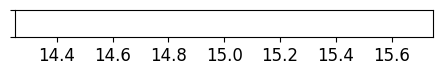

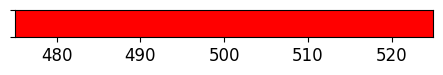

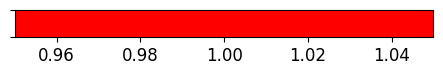

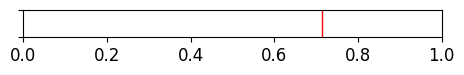

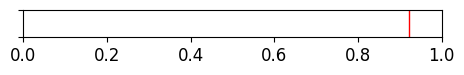

...

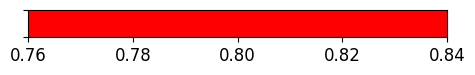

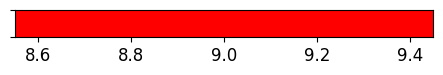

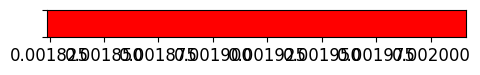

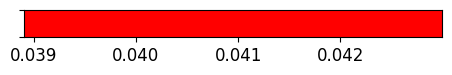

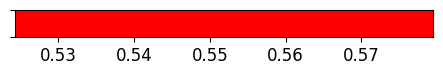

In [4]:
import json
import shutil
import os
from batch_run_files.aw_batch_tools import generate_all_figures
exclude_running = False
output_only = False
fresh_figs = False
for root, dirs, files in os.walk('/mnt/disk15tb/adam/git_workspace/netpyne_2DNetworkSimulations/2DNet_simulations/BurstingPlotDevelopment/nb5_optimizing'):
    for file in files:
        if file.endswith('_Fitness.json'):
            if '.archive' in root:
                continue
            if exclude_running and 'output/' in root: continue
            if output_only and 'output/' not in root: continue
            specific_output = root.split('optimizing/')[1].split('/gen_')[0]
            try:
                fitness = json.load(open(os.path.join(root, file)))
                overall_fitness = fitness['fitness']
            except:
                print(f'Error reading {file}')
            
            if overall_fitness < 350:
                print(f'Overall fitness for {file} is {overall_fitness}')
                print(f'Generating plots for {file}')
                #move_plots_to_plots_folder(root)
                #generate_pdf_reports(root, params)
                #print('Plots and pdf reports generated
            #print(fitness)
                batchdata_path = os.path.join(root, file.replace('_Fitness.json', '_data.json'))
                assert os.path.exists(batchdata_path), f'{batchdata_path} does not exist'
                try:
                    simLabel = batchdata_path.split('/')[-1].replace('_data.json', '')
                    run_path = os.path.dirname(os.path.dirname(batchdata_path))
                    run_basename = os.path.basename(run_path)
                    print(f'Generating plots for Candidate: {simLabel}, Run: {run_basename}')

                    # fresh_figs = False
                    assert os.path.exists(batchdata_path), f'{batchdata_path} does not exist'
                    cfg_path = batchdata_path.replace('_data.json', '_cfg.json')
                    assert os.path.exists(cfg_path), f'{cfg_path} does not exist'
                    fitness_path = batchdata_path.replace('_data.json', '_Fitness.json')
                    assert os.path.exists(fitness_path), f'{fitness_path} does not exist'

                    generate_all_figures(
                        fresh_figs = fresh_figs,
                        net_activity_params = {'binSize': .03*1000, 
                                            'gaussianSigma': .12*1000, 
                                            'thresholdBurst': 1.0},
                        batchLabel = 'batchRun_evol',
                        #batchLabel = params['filename'][0],
                        #minimum peak distance = 0.5 seconds
                        batch_path = batchdata_path
                    )

                    output_path = batchdata_path
                    output_path = os.path.dirname(output_path)
                    output_path = f'{output_path}/NetworkBurst_and_Raster_Figs/'
                    run_grand_path = os.path.dirname(run_path)
                    plot_row_path = f'{run_grand_path}/goodFit_plots_rows/'
                    if not os.path.exists(plot_row_path+specific_output):
                        os.makedirs(plot_row_path+specific_output)
                    ## shutil copy any files in output_path with the string 'row' in the name to plot path
                    for rooti, dirsi, filesi in os.walk(output_path):
                        if '.archive' in rooti: continue
                        
                        for filei in filesi:
                            if 'row' in filei:
                                if os.path.exists(plot_row_path+filei):
                                    if fresh_figs: os.remove(plot_row_path+specific_output+'/'+filei)
                                    else: continue
                                shutil.copy(rooti+'/'+filei, plot_row_path+specific_output+'/'+filei)
                except:
                    print(f'Error generating plots for {file}')
                    continue